In this notebook, we train and test a traffic sign detector on the German Traffic Sign dataset (TODO: add link here).
This algorithm and notebook is heavily based on the Fastai Lesson 9 notebook: https://github.com/fastai/fastai/blob/master/courses/dl2/pascal-multi.ipynb 

---
# Import python packages

In [1]:
# Put these at the top of every notebook, to get automatic reloading and inline plotting
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
import pickle
import random
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import skimage.data
import skimage.transform
import os
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np


In [3]:
from fastai.conv_learner import *
from fastai.dataset import *

import json, pdb
from PIL import ImageDraw, ImageFont
from matplotlib import patches, patheffects

# Load data

## Find representative image for every class

We first load the classification data in order to get a representative image for all classes

This data loading script below is mostly taken from https://medium.com/@waleedka/traffic-sign-recognition-with-tensorflow-629dffc391a6

In [4]:
def load_class_data(data_dir):
    # Get all subdirectories of data_dir. Each represents a label.
    directories = [d for d in os.listdir(data_dir) 
                   if os.path.isdir(os.path.join(data_dir, d))]
    # Loop through the label directories and collect the data in
    # tD:\Datasets\TrafficSigns\FullIJCNN2013wo lists, labels and images.
    labels = [] # list of labels
    images = [] # list of images
    images_per_class = [] # dataset organized by class
    for d in directories:
        label_dir = os.path.join(data_dir, d)
        file_names = [os.path.join(label_dir, f) 
                      for f in os.listdir(label_dir) 
                      if f.endswith(".ppm")]
        images_for_this_class = []
        for f in file_names:
            current_img = skimage.data.imread(f).astype(float)/255.0
            resized_img = skimage.transform.resize(current_img, (32, 32))
            images.append(resized_img)
            labels.append(int(d))
            images_for_this_class.append(current_img)
            
        images_per_class.append(images_for_this_class)
    return images, labels, images_per_class

data_path = 'D:\Datasets\TrafficSigns\TrainIJCNN2013'
class_data_dir =  data_path  + '\ClassPics'
#detec_data_dir =  data_path  + '\DetecPics'
class_images, class_labels, images_per_class = load_class_data(class_data_dir)
#detec_images, detec_labels = load_data(detec_data_dir)

class_images_np = np.asarray(class_images)
class_labels_np = np.asarray(class_labels)
images_per_class_np  = np.asarray(images_per_class)
print(class_images_np.shape)
print(class_labels_np.shape)
print(images_per_class_np.shape)

C:\ProgramData\Miniconda3\envs\fastai_env\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


(853, 32, 32, 3)
(853,)
(43,)


The visualization script below is mostly taken from: https://medium.com/@waleedka/traffic-sign-recognition-with-tensorflow-629dffc391a6

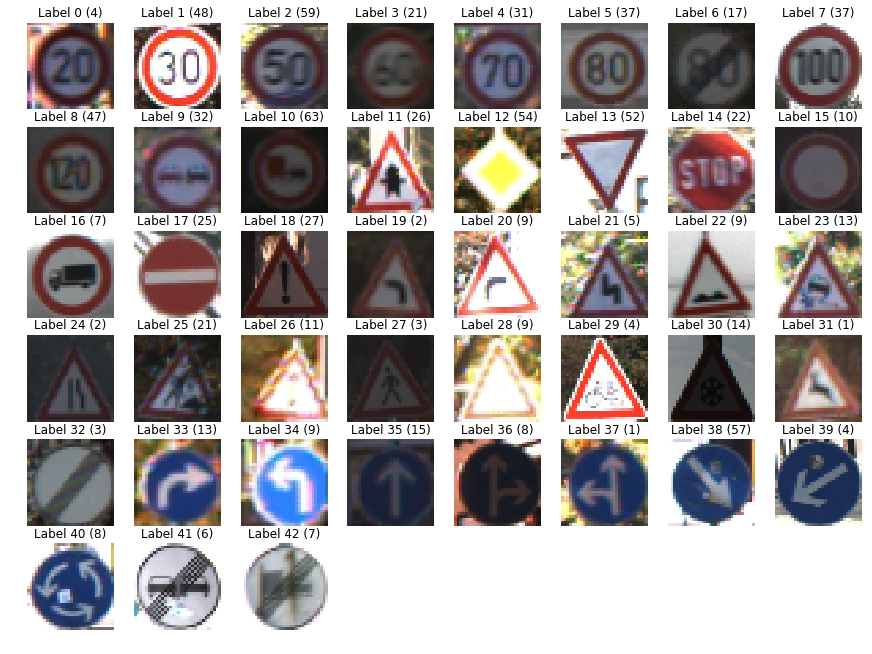

In [5]:
def display_images_and_labels(images, labels):
    """Display the first image of each label."""
    unique_labels = set(labels)
    plt.figure(figsize=(15, 15))
    i = 1
    for label in unique_labels:
        # Pick the first image for each label.
        image = images[labels.index(label)]
        plt.subplot(8, 8, i)  # A grid of 8 rows x 8 columns
        plt.axis('off')
        plt.title("Label {0} ({1})".format(label, labels.count(label)))
        i += 1
        _ = plt.imshow(image)
    plt.show()

display_images_and_labels(class_images, class_labels)


## Load the detection dataset (full images with bounding boxes)

In [6]:
import pandas as pd
detec_data_dir =  data_path  + '\DetecPics'
detec_gt = pd.read_csv(detec_data_dir + '\gt.txt', sep = ';', header = None)
np_detec_gt = np.asarray(detec_gt)
n_anno = np_detec_gt.shape[0]
print('number of annotations detected:', n_anno)
print('number of attributes per sign detection:', np_detec_gt.shape[1])

number of annotations detected: 852
number of attributes per sign detection: 6


## Create useful dictionaries

Create a dictionary containing a representative image for each class

avg rep image value: 0.36159252231358496


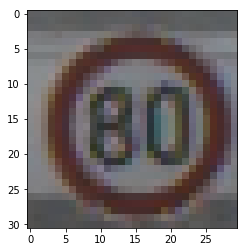

In [7]:
rep_imgs = dict((i, images_per_class_np[i][0]) for i in range(0,images_per_class_np.shape[0]))
n_classes = len(rep_imgs)
print('avg rep image value:', np.average(rep_imgs[5]))
plt.imshow(rep_imgs[5])
plt.show()

In [8]:
def get_trn_anno():
    trn_anno = collections.defaultdict(lambda:[])
    trn_cat = collections.defaultdict(lambda:[])
    trn_bboxes = collections.defaultdict(lambda:[])
    for i in range(0,n_anno):
        bb = np_detec_gt[i][1:5]
        bb[0],bb[1] = bb[1],bb[0] ## We swap x and y values to have bbox in a height width order
        bb[2],bb[3] = bb[3],bb[2]
        cat_id = np_detec_gt[i][5]
        trn_anno[np_detec_gt[i][0]].append((bb,cat_id))
        trn_cat[np_detec_gt[i][0]].append(cat_id)
        trn_bboxes[np_detec_gt[i][0]].append(bb)
    return trn_anno,trn_cat,trn_bboxes

trn_anno,trn_cat,trn_bboxes = get_trn_anno()

In [9]:
from tqdm import tqdm, trange
trn_imgs = dict((np_detec_gt[i][0], 
                 plt.imread((detec_data_dir + '\\' + np_detec_gt[i][0]))/255.0) for i in tqdm(range(0,n_anno)))

100%|████████████████████████████████████████████████████████████████████████████████| 852/852 [00:29<00:00, 29.10it/s]


## Create class and bounding boxes visualization

[(array([443, 484, 463, 504], dtype=object), 10), (array([431, 909, 453, 931], dtype=object), 10)]
[10, 10]
avg img value: 0.4701711733467896


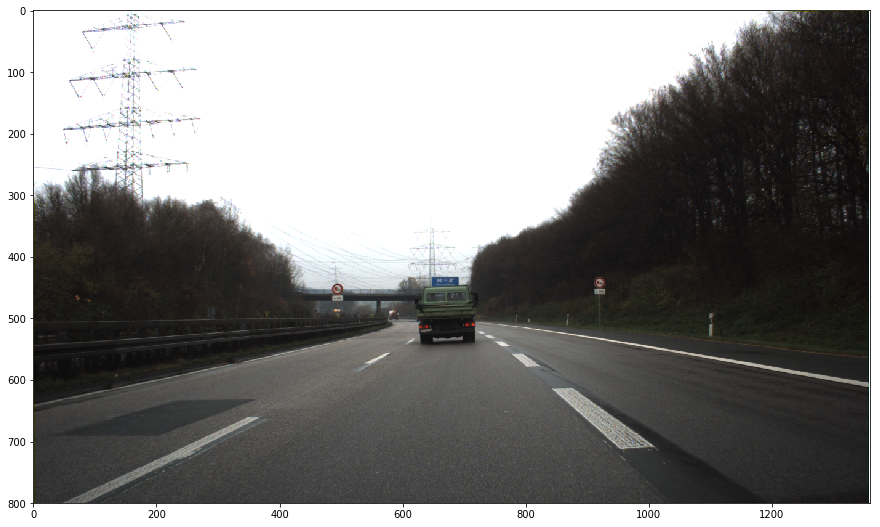

In [10]:
fig,ax = plt.subplots(nrows = 1, ncols = 1,figsize=(15, 15))
index = random.randint(0, np_detec_gt.shape[0])
img_name = np_detec_gt[index][0] 
#img_name = next(iter(trn_imgs))
print(trn_anno[img_name])
print(trn_cat[img_name])
print('avg img value:',np.average(trn_imgs[img_name]))
ax.imshow(trn_imgs[img_name])
plt.show()

In [11]:
def show_img(im, figsize=None, ax=None):
    if not ax: fig,ax = plt.subplots(figsize=figsize)
    ax.imshow(im)
    ax.set_xticks(np.linspace(0, 224, 8))
    ax.set_yticks(np.linspace(0, 224, 8))
    ax.grid()
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    return ax

bboxes: [array([443, 484, 463, 504], dtype=object), array([431, 909, 453, 931], dtype=object)]
classes: [10, 10]
verbose True
number of traffic signs in the image: 2
average value of the image: 0.4701711733467896
avg_rep_img: 0.14164985610156272
sz_rep_img: (27, 27, 3)


C:\ProgramData\Miniconda3\envs\fastai_env\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


avg_rep_img: 0.14164985610156272
sz_rep_img: (27, 27, 3)


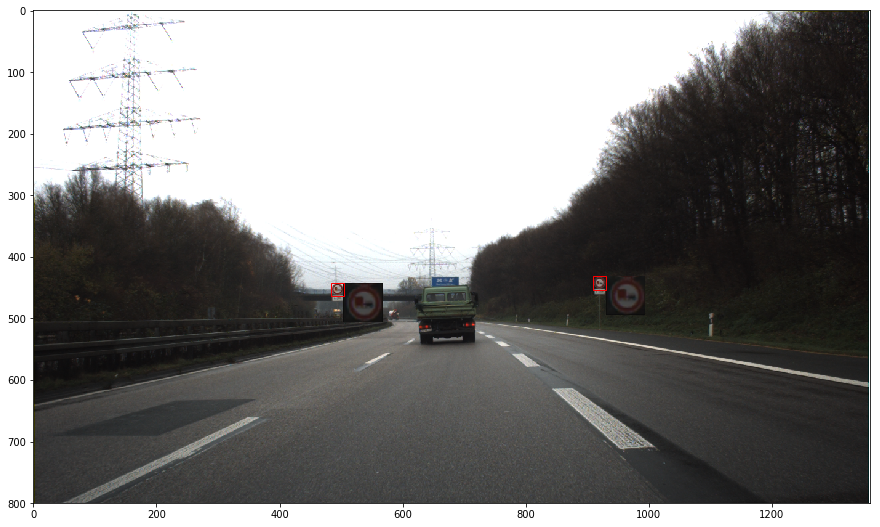

In [12]:
def show_image_with_ts_and_bb(image,bboxes,classes,rep_imgs,ts_thumbnails_size=64,verbose=False,figsize=(15, 15), ax=None):
    if not ax: fig,ax = plt.subplots(figsize=figsize)
    if len(classes) != len(bboxes):
        assert "the number of classes and bounding boxes should be the same"
    num_ts_in_pic = len(classes)
    aug_image = np.array(image)
    aug_image.setflags(write=True)
    img_height,img_width,_ = aug_image.shape
    if verbose:
        print('number of traffic signs in the image:',num_ts_in_pic)
        print('average value of the image:',np.average(aug_image))
    for (bb,class_id) in zip(bboxes,classes):
        left_col = bb[1]
        top_row = bb[0]
        right_col = bb[3]
        bottom_row = bb[2]
        class_repimage = rep_imgs[class_id]
        if verbose:
            print('avg_rep_img:',np.average(class_repimage))
            print('sz_rep_img:',class_repimage.shape)
        bb_width = right_col - left_col
        bb_height = bottom_row - top_row
        # Careful not to go out of image boundaries!
        label_height = min(ts_thumbnails_size,img_height-bottom_row-1) 
        label_width = min(ts_thumbnails_size,img_width-right_col-1)
        class_repimage_resized = skimage.transform.resize(class_repimage, (label_height, label_width))
        aug_image[top_row:top_row+label_height,
                  right_col:right_col+label_width,:]=class_repimage_resized[:][:][:]
        rect = patches.Rectangle((left_col,top_row),bb_width,bb_height,linewidth=1,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
        
    ax.imshow(aug_image) 
    return ax
    #plt.imsave('TSD_GT_image_6_no_class_img.png',image)

def show_aug_image_from_gt(img_name,trn_anno,trn_imgs,rep_imgs,ts_thumbnails_size=64,verbose=False,ax=None):
    bboxes,classes = ([ bb for bb,clss in trn_anno[img_name] ], [ clss for bb,clss in trn_anno[img_name] ])
    if verbose:
        print('bboxes:',bboxes)
        print('classes:',classes)
        print('verbose',verbose)
    show_image_with_ts_and_bb(trn_imgs[img_name],bboxes,classes,rep_imgs,verbose=verbose)

show_aug_image_from_gt(img_name,trn_anno,trn_imgs,rep_imgs,verbose=True)

C:\ProgramData\Miniconda3\envs\fastai_env\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


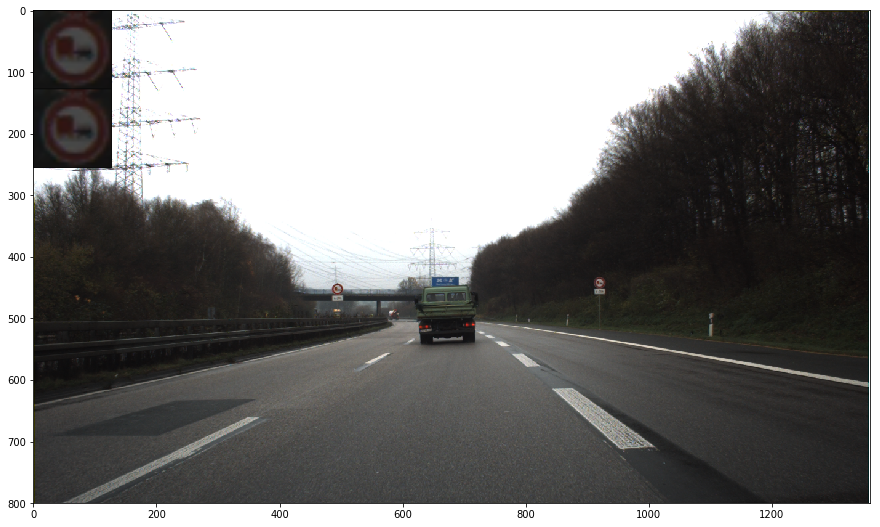

In [13]:
def show_image_ts_without_bb(img,classes,rep_imgs,ts_thumbnails_size = 128, verbose=False,ax=None):    
    bboxes =[]
    for i in range(0,len(classes)):
        bboxes.append(np.asarray([ts_thumbnails_size*i,0,ts_thumbnails_size*i,0]))
    if verbose: 
        print(bboxes)
    ax=show_image_with_ts_and_bb(img,bboxes,classes,rep_imgs,ts_thumbnails_size,ax=ax)
    return ax

classes=[ clss for bb,clss in trn_anno[img_name] ]
classes=trn_cat[img_name]
show_image_ts_without_bb(trn_imgs[img_name],classes,rep_imgs,verbose=False)

# Prepare Numpy Data Loader

## Prepare the dataset

In [14]:
PATH = Path(data_path)
f_model=resnet34
sz=448
bs=16

In [15]:
def unpack_bboxes(bboxes,rescalers):
    (rescale_factor_h,rescale_factor_w)=rescalers
    num_bb=len(bboxes)
    bb_vec=np.zeros((num_bb*4,1))
    bb_mat=np.zeros((num_bb,4))
    i=0
    for bb in bboxes:
        bb_vec[4*i]=round(rescale_factor_h*bb[0])
        bb_vec[4*i+1]=round(rescale_factor_w*bb[1])
        bb_vec[4*i+2]=round(rescale_factor_h*bb[2])
        bb_vec[4*i+3]=round(rescale_factor_w*bb[3])
        i=i+1
    bb_vec = bb_vec[np.nonzero(bb_vec)].astype(int)
    bb_mat = bb_vec.reshape(bb_vec.shape[0]//4,4)
    return bb_vec,bb_mat

def bb_vec_pad_2_bb_mat(bb_vec_padded):
    #remove 0 padding
    bb_vec = bb_vec_padded[np.nonzero(bb_vec_padded)]
    #create matrix
    bb_mat = bb_vec.reshape(bb_vec.shape[0]//4,4).astype(int)
    return bb_mat

In [16]:
n_train = len(trn_bboxes)
print("n_train",n_train)
x_train_tot = np.zeros((n_train,sz,sz,3))
y_bb_train_tot = np.zeros((n_train,28)) # is just a random very high number  
y_cl_train_tot = np.zeros((n_train,28)) # same thing  

for i,img_name in tqdm(zip(range(0,n_train),trn_bboxes)):
    img = trn_imgs[img_name]
    orig_height,orig_width,_ = img.shape
    rescalers = (sz/orig_height , sz/orig_width)
    img_sz = skimage.transform.resize(img, (sz, sz))
    x_train_tot[i] = img_sz
    bb_vec,_ = unpack_bboxes(trn_bboxes[img_name],rescalers)
    y_bb_train_tot[i][:len(bb_vec)]=bb_vec
    n_cat = len(trn_cat[img_name])
    y_cl_train_tot[i][:n_cat]=np.asarray(trn_cat[img_name])
    

n_train 506


0it [00:00, ?it/s]C:\ProgramData\Miniconda3\envs\fastai_env\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
506it [01:19,  6.37it/s]


[[234 335 248 342]
 [216 333 234 344]]


C:\ProgramData\Miniconda3\envs\fastai_env\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


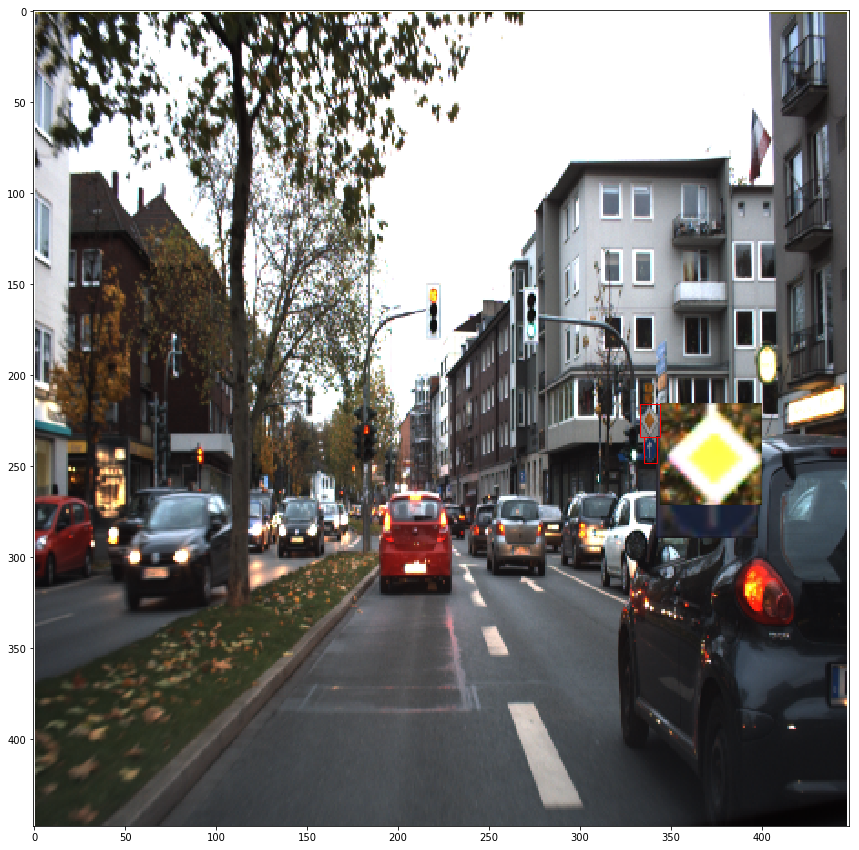

In [17]:
index = random.randint(0,n_train)
img_sz = x_train_tot[index]
bb_vec_pad = y_bb_train_tot[index][:]
bb_mat = bb_vec_pad_2_bb_mat(bb_vec_pad)
print(bb_mat)
classes = y_cl_train_tot[index,:]
classes = classes[np.nonzero(classes)]
show_image_with_ts_and_bb(img_sz,bb_mat,classes,rep_imgs,ts_thumbnails_size=sz//8,verbose=False)

## Create the dataloader and dataset

In [264]:
val_idxs = get_cv_idxs(len(trn_cat))
((x_val,x_trn),) = split_by_idx(val_idxs, x_train_tot)
((y_bb_val,y_bb_trn),) = split_by_idx(val_idxs, y_bb_train_tot)
((y_cl_val,y_cl_trn),) = split_by_idx(val_idxs, y_cl_train_tot)

In [265]:
def get_data(sz,bs,max_rot_deg=5,random_light=0.1,max_zoom = 1.0):
    aug_tfms = [RandomRotate(max_rot_deg, p=0.5, tfm_y=TfmType.COORD),
            RandomLighting(random_light, 0.1, tfm_y=TfmType.COORD)]
    tfms = tfms_from_model(f_model, sz, crop_type=CropType.NO, aug_tfms=aug_tfms, tfm_y=TfmType.COORD,max_zoom=max_zoom)
    md = ImageClassifierData.from_arrays(PATH,trn=(x_trn,y_bb_trn),val=(x_val,y_bb_val),tfms=tfms,bs=bs,num_workers=4)
    return md
md = get_data(sz=sz,bs=bs)

In [266]:
class ConcatLblDataset(Dataset):
    def __init__(self, ds, y2):
        self.ds,self.y2 = ds,y2
        self.sz = ds.sz
    def __len__(self): return len(self.ds)
    
    def __getitem__(self, i):
        x,y = self.ds[i]
        return (x, (y,self.y2[i]))

In [267]:
## VERY IMPORTANT: Don't forget to convert class GT into int
y_cl_trn = y_cl_trn.astype(int)
y_cl_val = y_cl_val.astype(int)

In [268]:
y_cl_trn.shape

(405, 28)

In [269]:
def concat_class_labels():
    trn_ds2 = ConcatLblDataset(md.trn_ds, y_cl_trn)
    val_ds2 = ConcatLblDataset(md.val_ds, y_cl_val)
    md.trn_dl.dataset = trn_ds2
    md.val_dl.dataset = val_ds2

concat_class_labels()

## Optional - Play with the data

In [ ]:
x,y = next(iter(md.val_dl))
x,y = V(x),V(y)

In [ ]:
print(x.shape)
print(to_np(x).shape)

In [ ]:
ex_bboxes=y[0]
ex_bboxes

In [ ]:
ex_classes=y[1]
ex_classes

In [ ]:
print(to_np(x).shape)
print(np.min(to_np(x)))
print(np.max(to_np(x)))

In [ ]:
x= np.moveaxis(to_np(x),1,3) # reorder the axis so that the channels are at the end
x.shape

In [ ]:
print(np.min(md.val_ds.ds.transform.denorm(to_np(x))))
print(np.max(md.val_ds.ds.transform.denorm(to_np(x))))

In [ ]:
md.val_ds.ds ## Note that we need another .ds because of the label concatenation that we made

## Optional - Visualize an example of data

In [ ]:
x,y = next(iter(md.val_dl))
x,y = V(x),V(y)

In [ ]:
x= np.moveaxis(to_np(x),1,3) # reorder the axis so that the channels are at the end

In [ ]:
print('Bounding Boxes', y[0])
print('Classes present', y[1])

In [ ]:
index = random.randint(0,bs-1)
image = md.val_ds.ds.transform.denorm(to_np(x))[index]
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image)
plt.show()

In [ ]:
classes = to_np(y)[1][index]
print('average image value:', np.average(image))
print('image shape', image.shape)
print('labels shape',classes.shape)
classes_gt = classes[classes !=0]
print('labels:', classes_gt)

In [ ]:
show_image_ts_without_bb(image,classes_gt,rep_imgs,ts_thumbnails_size=sz//8,verbose=False)

In [ ]:
bbox = to_np(y[0][index])
bb_mat = bb_vec_pad_2_bb_mat(bbox)
show_image_with_ts_and_bb(image,bb_mat,classes_gt,rep_imgs,ts_thumbnails_size=32)

In [ ]:
index

# Define the model

## Define the ResNet's head architecture

In [270]:
class StdConv(nn.Module):
    def __init__(self, nin, nout, stride=2, drop=0.3):
        super().__init__()
        self.conv = nn.Conv2d(nin, nout, 3, stride=stride, padding=1)
        self.bn = nn.BatchNorm2d(nout)
        self.drop = nn.Dropout(drop)
        
    def forward(self, x): return self.drop(self.bn(F.relu(self.conv(x))))
        
def flatten_conv(x,k):
    bs,nf,gx,gy = x.size()
    x = x.permute(0,2,3,1).contiguous()
    return x.view(bs,-1,nf//k)

In [271]:
class OutConv(nn.Module):
    def __init__(self, k, nin, bias):
        super().__init__()
        self.k = k
        self.oconv1 = nn.Conv2d(nin, (n_classes+1)*k, 3, padding=1)
        self.oconv2 = nn.Conv2d(nin, 4*k, 3, padding=1)
        self.oconv1.bias.data.zero_().add_(bias)
        
#    def forward(self, x):
#        return [self.oconv1(x),
#                self.oconv2(x)]
    def forward(self, x):
        return [flatten_conv(self.oconv1(x), self.k),
                flatten_conv(self.oconv2(x), self.k)]

In [272]:
class SSD_Head(nn.Module):
    def __init__(self, k, bias):
        super().__init__()
        self.drop = nn.Dropout(0.75)
        self.sconv0 = StdConv(512,256, stride=1)
#         self.sconv1 = StdConv(256,256)
        self.sconv2 = StdConv(256,256, stride=1)
        self.out = OutConv(k, 256, bias)
        
    def forward(self, x):
        x = self.drop(F.relu(x))
        x = self.sconv0(x)
#         x = self.sconv1(x)
        x = self.sconv2(x)
        return self.out(x)

## Create the model

In [318]:
k=1
head_reg4 = SSD_Head(k, -3.)
models = ConvnetBuilder(f_model, 0, 0, 0, custom_head=head_reg4)
learn = ConvLearner(md, models)
learn.opt_fn = optim.Adam

In [319]:
learn.summary() ## Check that the number of outputs correspond to the number of Anchors

OrderedDict([('Conv2d-1',
              OrderedDict([('input_shape', [-1, 3, 448, 448]),
                           ('output_shape', [-1, 64, 224, 224]),
                           ('trainable', False),
                           ('nb_params', 9408)])),
             ('BatchNorm2d-2',
              OrderedDict([('input_shape', [-1, 64, 224, 224]),
                           ('output_shape', [-1, 64, 224, 224]),
                           ('trainable', False),
                           ('nb_params', 128)])),
             ('ReLU-3',
              OrderedDict([('input_shape', [-1, 64, 224, 224]),
                           ('output_shape', [-1, 64, 224, 224]),
                           ('nb_params', 0)])),
             ('MaxPool2d-4',
              OrderedDict([('input_shape', [-1, 64, 224, 224]),
                           ('output_shape', [-1, 64, 112, 112]),
                           ('nb_params', 0)])),
             ('Conv2d-5',
              OrderedDict([('input_shape', [-1, 64, 11

## Define the anchor grid

In [320]:
anc_grid = 14
k = 1

anc_offset = 1/(anc_grid*2)
anc_x = np.repeat(np.linspace(anc_offset, 1-anc_offset, anc_grid), anc_grid)
anc_y = np.tile(np.linspace(anc_offset, 1-anc_offset, anc_grid), anc_grid)

anc_ctrs = np.tile(np.stack([anc_x,anc_y], axis=1), (k,1))
anc_sizes = np.array([[1/anc_grid,1/anc_grid] for i in range(anc_grid*anc_grid)])
anchors = V(np.concatenate([anc_ctrs, anc_sizes], axis=1), requires_grad=False).float()

In [321]:
grid_sizes = V(np.array([1/anc_grid]), requires_grad=False).unsqueeze(1)

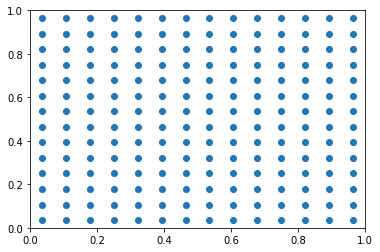

In [322]:
plt.scatter(anc_x, anc_y)
plt.xlim(0, 1)
plt.ylim(0, 1);

In [323]:
anchors

Variable containing:
 0.0357  0.0357  0.0714  0.0714
 0.0357  0.1071  0.0714  0.0714
 0.0357  0.1786  0.0714  0.0714
 0.0357  0.2500  0.0714  0.0714
 0.0357  0.3214  0.0714  0.0714
 0.0357  0.3929  0.0714  0.0714
 0.0357  0.4643  0.0714  0.0714
 0.0357  0.5357  0.0714  0.0714
 0.0357  0.6071  0.0714  0.0714
 0.0357  0.6786  0.0714  0.0714
 0.0357  0.7500  0.0714  0.0714
 0.0357  0.8214  0.0714  0.0714
 0.0357  0.8929  0.0714  0.0714
 0.0357  0.9643  0.0714  0.0714
 0.1071  0.0357  0.0714  0.0714
 0.1071  0.1071  0.0714  0.0714
 0.1071  0.1786  0.0714  0.0714
 0.1071  0.2500  0.0714  0.0714
 0.1071  0.3214  0.0714  0.0714
 0.1071  0.3929  0.0714  0.0714
 0.1071  0.4643  0.0714  0.0714
 0.1071  0.5357  0.0714  0.0714
 0.1071  0.6071  0.0714  0.0714
 0.1071  0.6786  0.0714  0.0714
 0.1071  0.7500  0.0714  0.0714
 0.1071  0.8214  0.0714  0.0714
 0.1071  0.8929  0.0714  0.0714
 0.1071  0.9643  0.0714  0.0714
 0.1786  0.0357  0.0714  0.0714
 0.1786  0.1071  0.0714  0.0714
 0.1786  0.1786  0.

In [324]:
def hw2corners(ctr, hw): return torch.cat([ctr-hw/2, ctr+hw/2], dim=1)

In [325]:
anchor_cnr = hw2corners(anchors[:,:2], anchors[:,2:])
anchor_cnr

Variable containing:
 0.0000  0.0000  0.0714  0.0714
 0.0000  0.0714  0.0714  0.1429
 0.0000  0.1429  0.0714  0.2143
 0.0000  0.2143  0.0714  0.2857
 0.0000  0.2857  0.0714  0.3571
 0.0000  0.3571  0.0714  0.4286
 0.0000  0.4286  0.0714  0.5000
 0.0000  0.5000  0.0714  0.5714
 0.0000  0.5714  0.0714  0.6429
 0.0000  0.6429  0.0714  0.7143
 0.0000  0.7143  0.0714  0.7857
 0.0000  0.7857  0.0714  0.8571
 0.0000  0.8571  0.0714  0.9286
 0.0000  0.9286  0.0714  1.0000
 0.0714  0.0000  0.1429  0.0714
 0.0714  0.0714  0.1429  0.1429
 0.0714  0.1429  0.1429  0.2143
 0.0714  0.2143  0.1429  0.2857
 0.0714  0.2857  0.1429  0.3571
 0.0714  0.3571  0.1429  0.4286
 0.0714  0.4286  0.1429  0.5000
 0.0714  0.5000  0.1429  0.5714
 0.0714  0.5714  0.1429  0.6429
 0.0714  0.6429  0.1429  0.7143
 0.0714  0.7143  0.1429  0.7857
 0.0714  0.7857  0.1429  0.8571
 0.0714  0.8571  0.1429  0.9286
 0.0714  0.9286  0.1429  1.0000
 0.1429  0.0000  0.2143  0.0714
 0.1429  0.0714  0.2143  0.1429
 0.1429  0.1429  0.

In [326]:
n_clas = n_classes+1
n_act = k*(4+n_clas)

# Define the loss function

In [327]:
import pdb

In [328]:
def one_hot_embedding(labels, num_classes):
    #pdb.set_trace()
    return torch.eye(num_classes)[labels.data.cpu()]

class BCE_Loss(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.num_classes = num_classes

    def forward(self, pred, targ):
        t = one_hot_embedding(targ, self.num_classes+1)
        t = V(t[:,:-1].contiguous())#.cpu()
        x = pred[:,:-1]
        w = self.get_weight(x,t)
        return F.binary_cross_entropy_with_logits(x, t, w, size_average=False)/self.num_classes
    
    def get_weight(self,x,t): return None

loss_f = BCE_Loss(n_classes)

Run the cell below only if you want to use the Focal Loss (https://arxiv.org/pdf/1708.02002.pdf)
We changed the alpha and gamma values compared to the original pacal-multi notebook because there are even more background examples in the training set.

In [329]:
class FocalLoss(BCE_Loss):
    def get_weight(self,x,t):
        alpha,gamma = 0.9,1
        p = x.sigmoid()
        pt = p*t + (1-p)*(1-t)
        w = alpha*t + (1-alpha)*(1-t)
        return w * (1-pt).pow(gamma)

loss_f = FocalLoss(n_classes)

In [330]:
def intersect(box_a, box_b):
    max_xy = torch.min(box_a[:, None, 2:], box_b[None, :, 2:])
    min_xy = torch.max(box_a[:, None, :2], box_b[None, :, :2])
    inter = torch.clamp((max_xy - min_xy), min=0)
    return inter[:, :, 0] * inter[:, :, 1]

def box_sz(b): return ((b[:, 2]-b[:, 0]) * (b[:, 3]-b[:, 1]))

def jaccard(box_a, box_b):
    inter = intersect(box_a, box_b)
    union = box_sz(box_a).unsqueeze(1) + box_sz(box_b).unsqueeze(0) - inter
    return inter / union

In [331]:
def get_y(bbox,clas):
    bbox = bbox.view(-1,4)/sz
    #bb_keep = ((bbox[:,2]-bbox[:,0])>-1).nonzero()[:,0]
    keep = bbox.sum(dim=1).nonzero()[:,0]
    return bbox[keep],clas[keep]

def actn_to_bb(actn, anchors):
    actn_bbs = torch.tanh(actn)
    actn_centers = (actn_bbs[:,:2]/2 * grid_sizes) + anchors[:,:2]
    actn_hw = (actn_bbs[:,2:]/2+1) * anchors[:,2:]
    return hw2corners(actn_centers, actn_hw)

def map_to_ground_truth(overlaps, print_it=False):
    #pdb.set_trace()
    prior_overlap, prior_idx = overlaps.max(1)
    if print_it: 
        print(prior_overlap)
        pdb.set_trace()
    gt_overlap, gt_idx = overlaps.max(0)
    gt_overlap[prior_idx] = 1.99
    for i,o in enumerate(prior_idx):
        gt_idx[o] = i
    return gt_overlap,gt_idx

def ssd_1_loss(b_c,b_bb,bbox,clas,print_it=False):
    #pdb.set_trace()
    bbox,clas = get_y(bbox,clas)
    a_ic = actn_to_bb(b_bb, anchors)
    overlaps = jaccard(bbox.data, anchor_cnr.data)
    gt_overlap,gt_idx = map_to_ground_truth(overlaps,print_it)
    gt_clas = clas[gt_idx]
    pos = gt_overlap > 0.1
    pos_idx = torch.nonzero(pos)[:,0]
    gt_clas[1-pos] = n_classes
    gt_bbox = bbox[gt_idx]
    loc_loss = ((a_ic[pos_idx] - gt_bbox[pos_idx]).abs()).mean()
    clas_loss  = loss_f(b_c, gt_clas)
    return loc_loss, clas_loss

def ssd_loss(pred,targ,print_it=False):
    lcs,lls = 0.,2.
    for b_c,b_bb,bbox,clas in zip(*pred,*targ):
        loc_loss,clas_loss = ssd_1_loss(b_c,b_bb,bbox,clas,print_it)
        lls += loc_loss
        lcs += clas_loss
    if print_it: print(f'loc: {lls.data[0]}, clas: {lcs.data[0]}')
    return lls+lcs

In [332]:
iterator = iter(md.val_dl)
x,y = next(iterator)
x,y = V(x),V(y)

In [333]:
batch = learn.model(x)

In [334]:
ssd_loss(batch, y, False)

Variable containing:
 4.9846
[torch.cuda.FloatTensor of size 1 (GPU 0)]

In [335]:
learn.crit = ssd_loss
lr = 1e-2

# Fit the model to the data

In [337]:
name_model = "TSD_448_fl_14x14_alpha09_gamma1_minoverlap01_nozoom_1cycle_bugfix"

In [338]:
bs=4
md = get_data(sz=sz,bs=bs,max_rot_deg=5,random_light=0.2,max_zoom=1.0)
concat_class_labels()
learn.set_data(md)

## Initial Training

In [339]:
lr=1e-2

epoch      trn_loss   val_loss                                                                                         
    0      3.298048   14.044476 



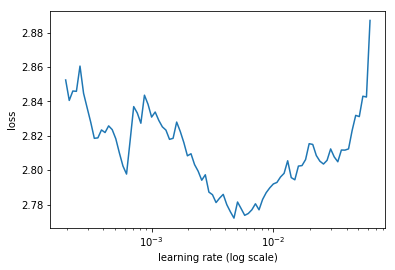

In [340]:
learn.lr_find(start_lr=lr/100,end_lr=1e-1)
learn.sched.plot()

In [341]:
lr=5e-3
#learn.fit(lr, 5, cycle_len=1)
learn.fit(lr, 1, cycle_len=5, use_clr_beta=(20,10,0.95,0.85),wds=1e-4)

epoch      trn_loss   val_loss                                                                                         
    0      2.683748   2.646051  
    1      2.567274   2.555293                                                                                         
    2      2.497001   2.522668                                                                                         
    3      2.402433   2.44358                                                                                          
    4      2.355627   2.434063                                                                                         



[array([2.43406])]

In [342]:
learn.save(name_model)

## Unfreeze all layers

In [343]:
learn.load(name_model)

In [344]:
learn.unfreeze()

In [345]:
lr = 1e-3
lrs = np.array([lr/9,lr/3,lr])

epoch      trn_loss   val_loss                                                                                         
    0      2.414981   4.302482  



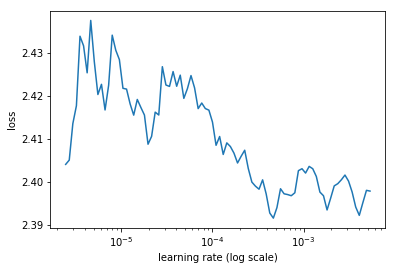

In [346]:
learn.lr_find(start_lr=lrs/1000,end_lr=1e-2)
learn.sched.plot()

In [347]:
lr = 5e-4
lrs = np.array([lr/9,lr/3,lr])

In [348]:
#learn.fit(lrs, 1, cycle_len=50)
learn.fit(lr, 1, cycle_len=10, use_clr_beta=(20,10,0.95,0.85),wds=1e-4)

epoch      trn_loss   val_loss                                                                                         
    0      2.348577   2.386922  
    1      2.298811   2.361125                                                                                         
    2      2.277504   2.351957                                                                                         
    3      2.258918   2.313622                                                                                         
    4      2.26275    2.401004                                                                                         
    5      2.245049   2.303414                                                                                         
    6      2.197421   2.284679                                                                                         
    7      2.159797   2.281774                                                                                         
    8  

[array([2.27426])]

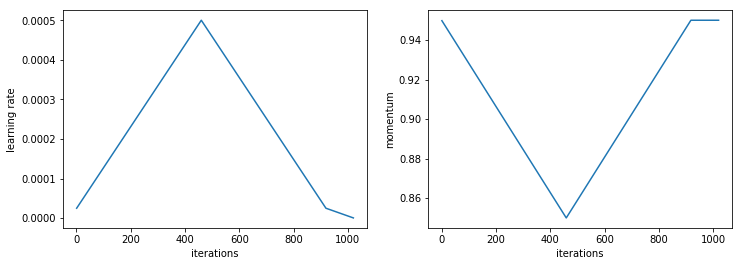

In [349]:
learn.sched.plot_lr()

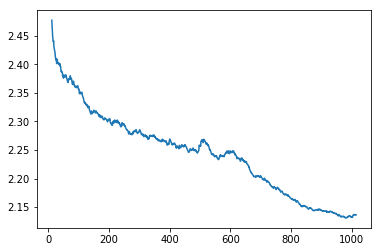

In [350]:
learn.sched.plot_loss()

In [351]:
learn.save(name_model)

## Optional: Further Training

In [234]:
learn.load(name_model)

The line below checks the status of the learnining

In [235]:
learn.fit(1e-10, 1, cycle_len=1)

epoch      trn_loss   val_loss                                                                                         
    0      2.107986   2.338931  



[array([2.33893])]

In [236]:
bs=4
md = get_data(sz=sz,bs=bs, max_rot_deg=10, random_light=0.2,max_zoom=1.0)
concat_class_labels()
learn.set_data(md)

In [237]:
learn.unfreeze()

In [238]:
lr = 1e-3
lrs = np.array([lr/25,lr/5,lr])

epoch      trn_loss   val_loss                                                                                         
    0      3.417226   1631556041.188119



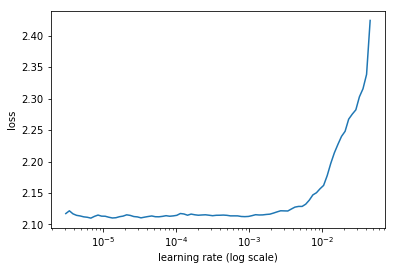

In [239]:
learn.lr_find(start_lr=lrs/1000,end_lr=1e-1)
learn.sched.plot()

In [390]:
lr = 1e-4
lrs = np.array([lr/9,lr/3,lr])

In [240]:
learn.fit(lrs, 1, cycle_len=15)

epoch      trn_loss   val_loss                                                                                         
    0      2.121153   2.390343  
    1      2.153073   2.362381                                                                                         
    2      2.141583   2.367346                                                                                         
    3      2.11985    2.410055                                                                                         
    4      2.099823   2.393276                                                                                         
    5      2.086653   2.393631                                                                                         
    6      2.072402   2.410095                                                                                         
    7      2.063756   2.445332                                                                                         
    8  

[array([2.48264])]

In [425]:
learn.save(name_model)

In [ ]:
learn.load(name_model)

# Test the model

## On random examples

In [352]:
learn.load(name_model)

In [353]:
bs=16
md = get_data(sz=sz,bs=bs)
concat_class_labels()

In [354]:
def load_batch(isTrain=False):
    if(isTrain):
        x,y = next(iter(md.trn_dl))
    else:
        x,y = next(iter(md.val_dl))
    x,y = V(x),V(y)
    learn.model.eval()
    batch = learn.model(x)
    b_clas,b_bb = batch
    x= np.moveaxis(to_np(x),1,3)
    return x,y,b_clas,b_bb

In [355]:
def display_random_res_on_batch(idx,thresh_conf=0.2,print_it=False,save=False,save_path=""):
    #idx = 38
    b_clasi = b_clas[idx]
    b_bboxi = b_bb[idx]
    ima=md.val_ds.ds.transform.denorm(to_np(x))[idx]
    classes_per_anch = to_np(b_clasi.max(1)[1])
    conf_per_anch = to_np(b_clasi.max(1)[0].sigmoid())
    a_ic = actn_to_bb(b_bboxi, anchors)
    est_bboxes = to_np(a_ic*sz)
    est_bboxes = np.rint(est_bboxes).astype(int)
    not_bg_idx = (classes_per_anch != 43)
    confident_idx = (conf_per_anch > thresh_conf)
    valid_idx = np.logical_and(not_bg_idx,confident_idx)
    classes = classes_per_anch[valid_idx]
    valid_bboxes = est_bboxes[valid_idx,:]
    if(print_it):
        print("classes_per_anch: ", classes_per_anch)
        print("conf_per_anch: ", conf_per_anch)
    if(save):
        fig = plt.figure(figsize=(15,15))
        ax = fig.add_subplot(1,1,1)
        ax = show_image_with_ts_and_bb(ima,valid_bboxes,classes,rep_imgs,ts_thumbnails_size=sz//8,ax=ax)
        fig.savefig(save_path)
    else:
        ax = show_image_with_ts_and_bb(ima,valid_bboxes,classes,rep_imgs,ts_thumbnails_size=sz//8)

In [356]:
x,y,b_clas,b_bb = load_batch(isTrain=False)

In [357]:
idx = random.randint(0,bs-1)

C:\ProgramData\Miniconda3\envs\fastai_env\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


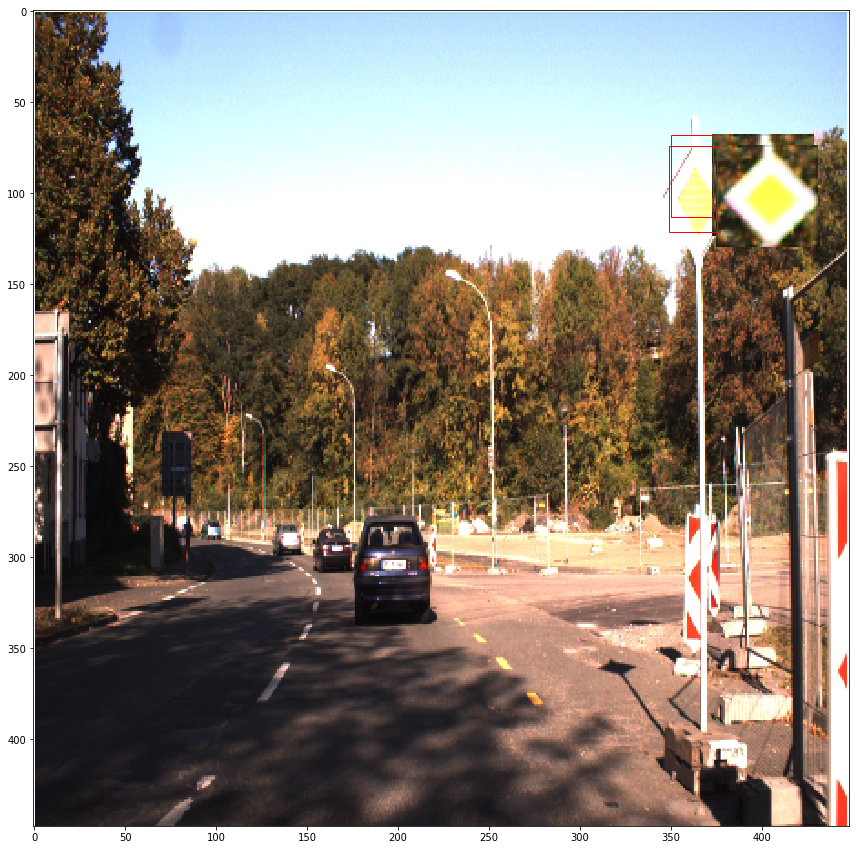

In [358]:
display_random_res_on_batch(idx,0.3,print_it=False,save=False,save_path = "")

## Save Results for both Training and Validation Set

In [359]:
import os
from shutil import copy
res_path = "D:\\Results\\TrafficSignDetec\\"+name_model
train_res_path = res_path+'\\train\\'
valid_res_path = res_path+'\\valid\\'
os.mkdir(res_path)

In [360]:
copy('./fastai_GTSD.ipynb', res_path)
os.mkdir(train_res_path)
os.mkdir(valid_res_path)

In [367]:
def write_results(res_path):
    for idx in tqdm(range(0,bs)):
        save_path = res_path+ "results_"+str(idx)+".png"
        display_random_res_on_batch(idx,0.3,print_it=False,save=True,save_path=save_path)

  0%|                                                                                           | 0/16 [00:00<?, ?it/s]C:\ProgramData\Miniconda3\envs\fastai_env\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
100%|██████████████████████████████████████████████████████████████████████████████████| 16/16 [00:04<00:00,  3.83it/s]


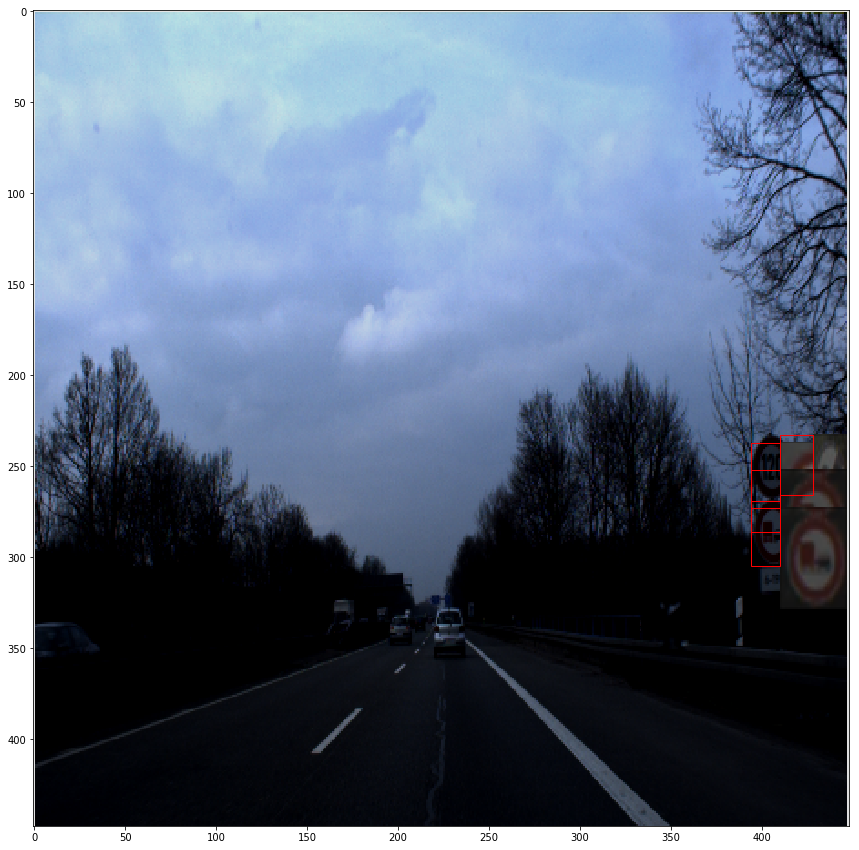

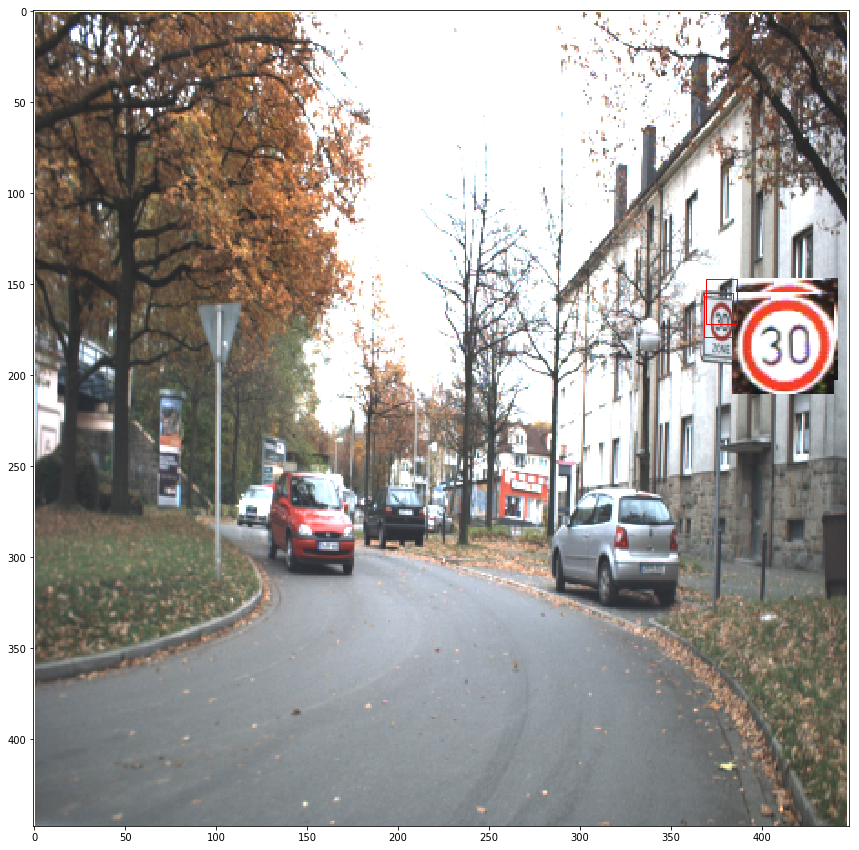

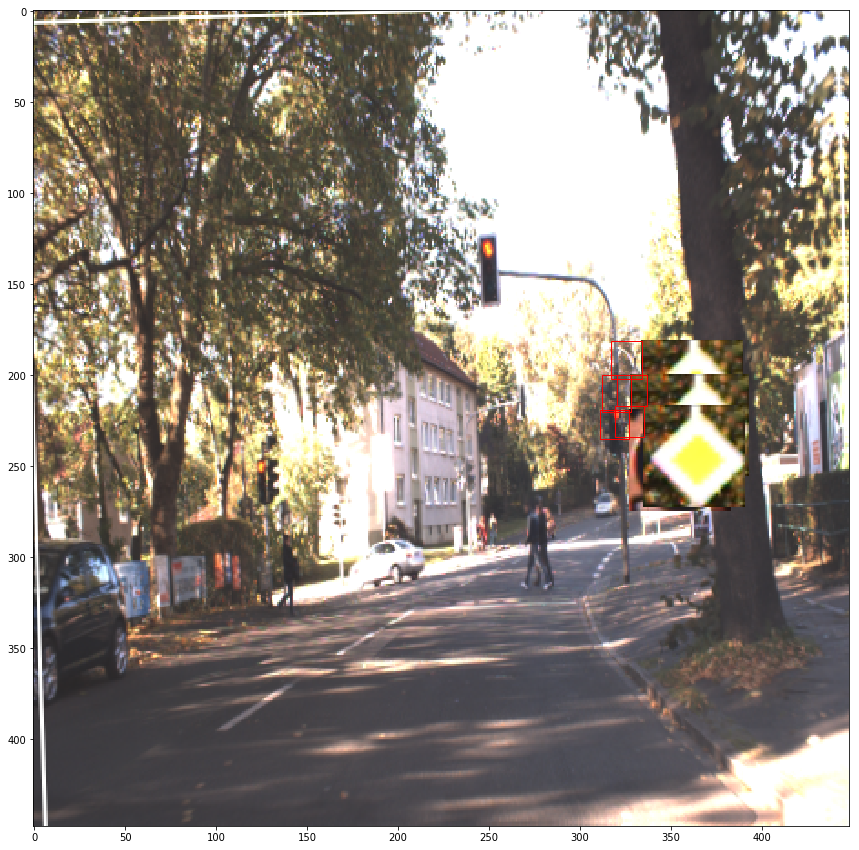

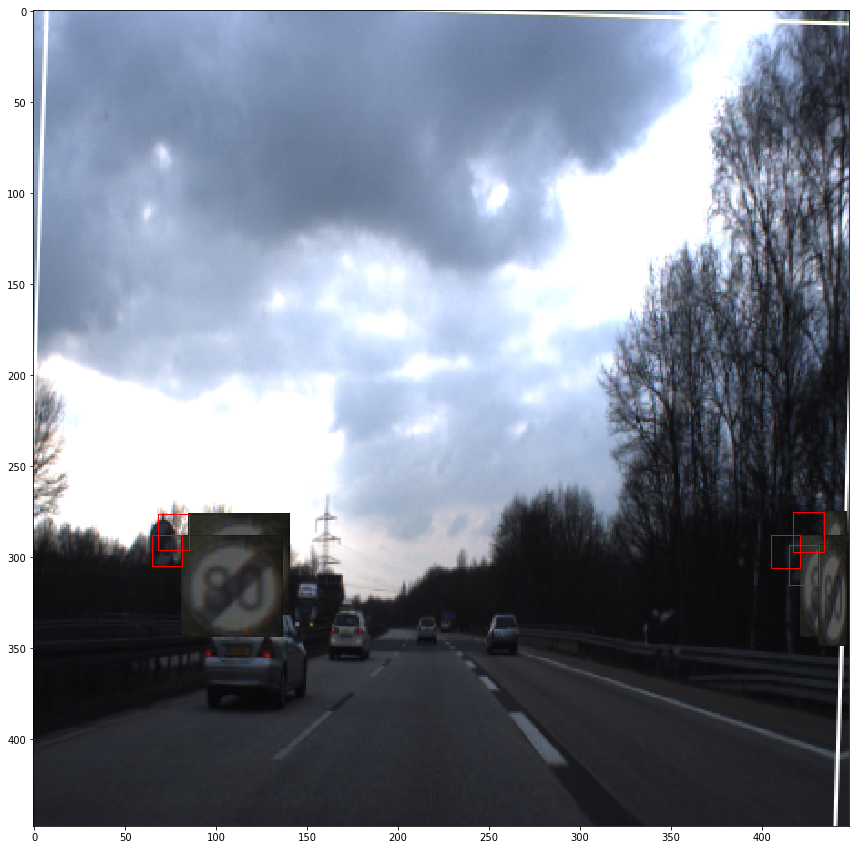

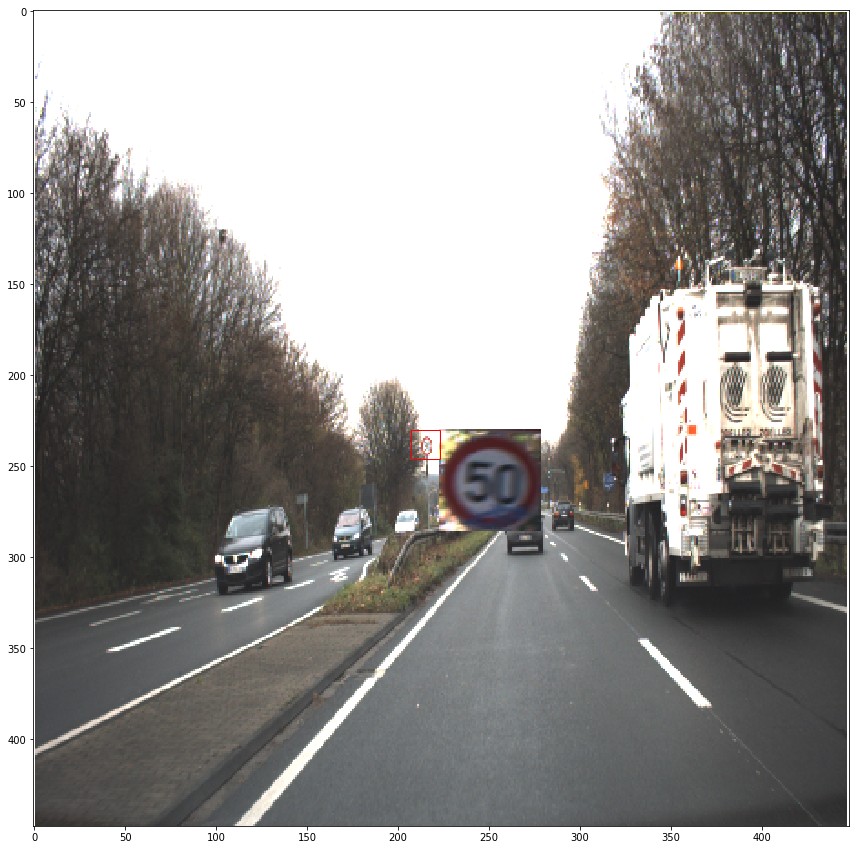

...

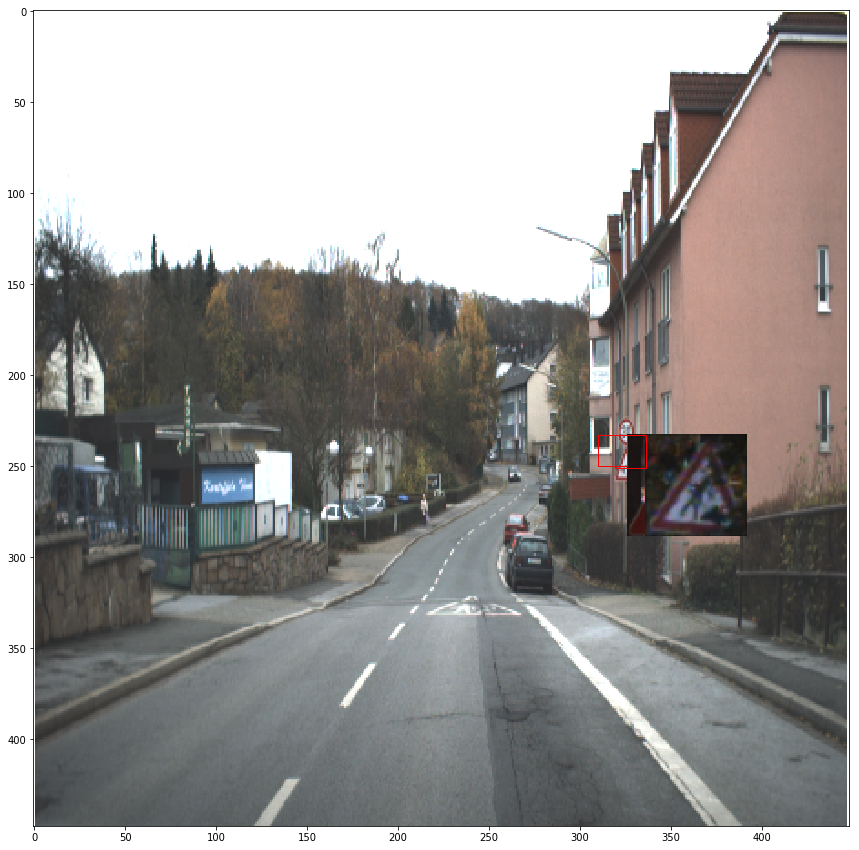

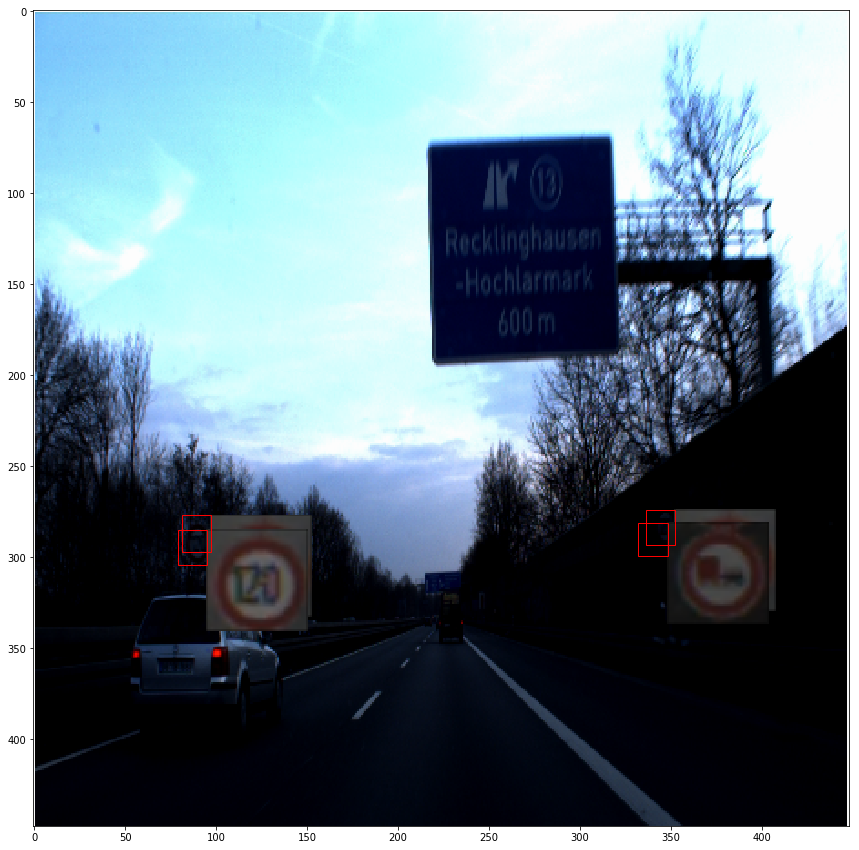

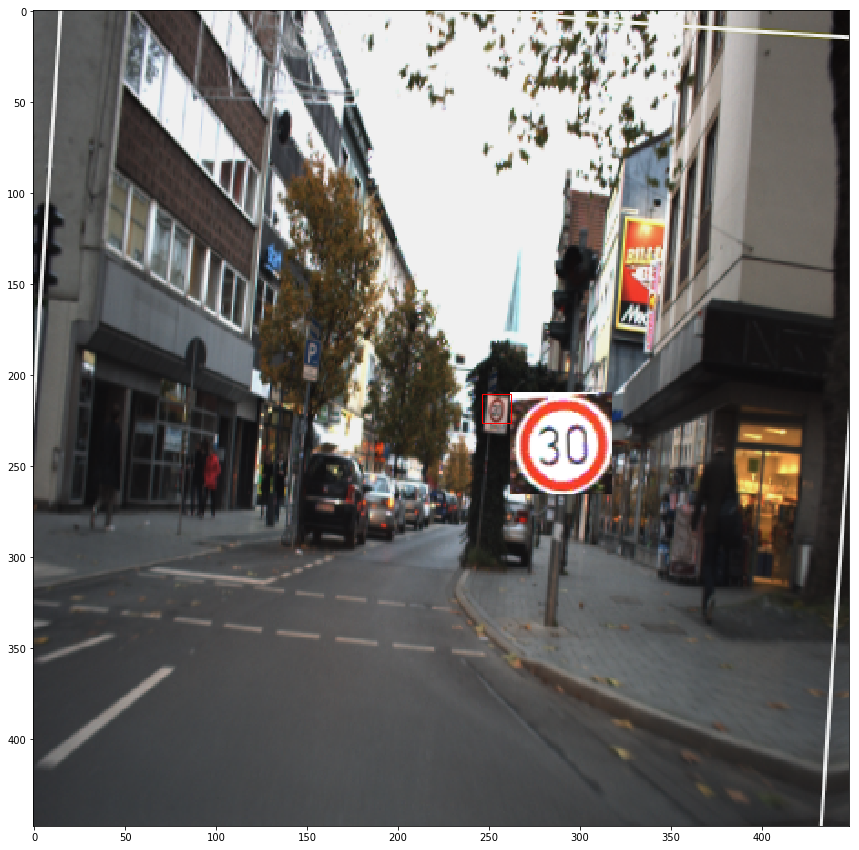

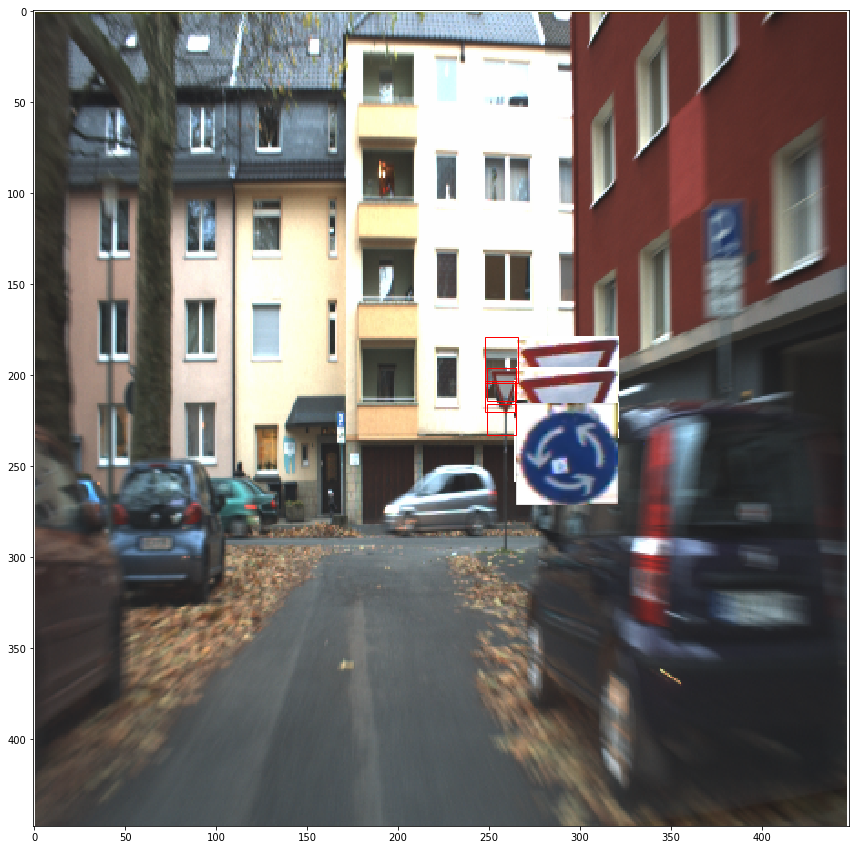

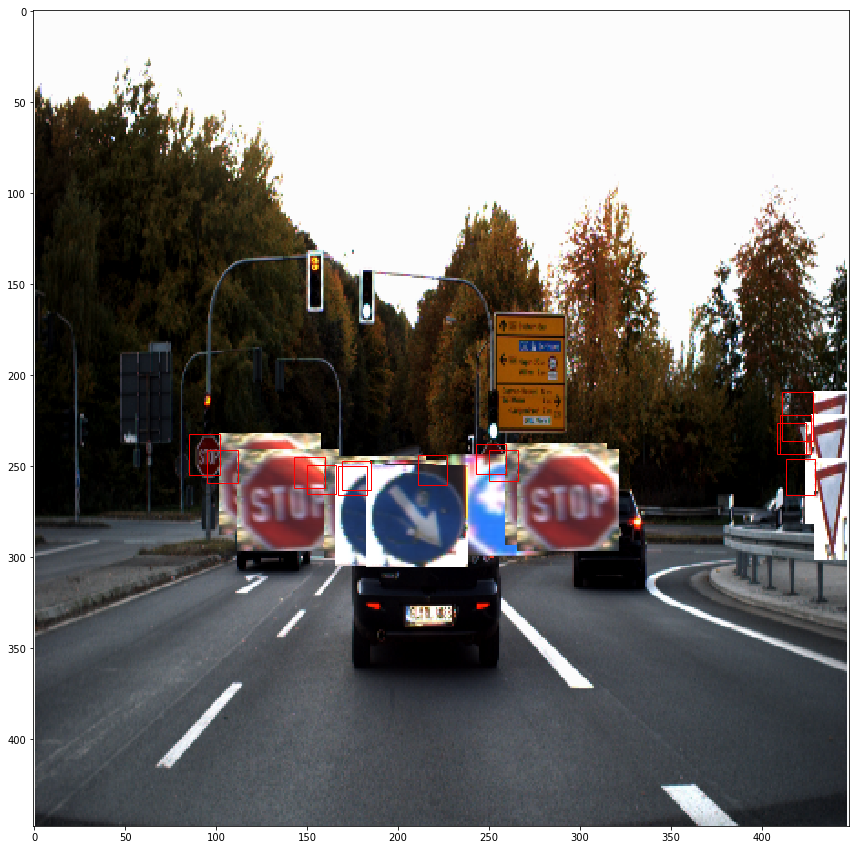

In [368]:
x,y,b_clas,b_bb=load_batch(isTrain=True)
write_results(train_res_path)

  0%|                                                                                           | 0/16 [00:00<?, ?it/s]C:\ProgramData\Miniconda3\envs\fastai_env\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
100%|██████████████████████████████████████████████████████████████████████████████████| 16/16 [00:04<00:00,  3.68it/s]


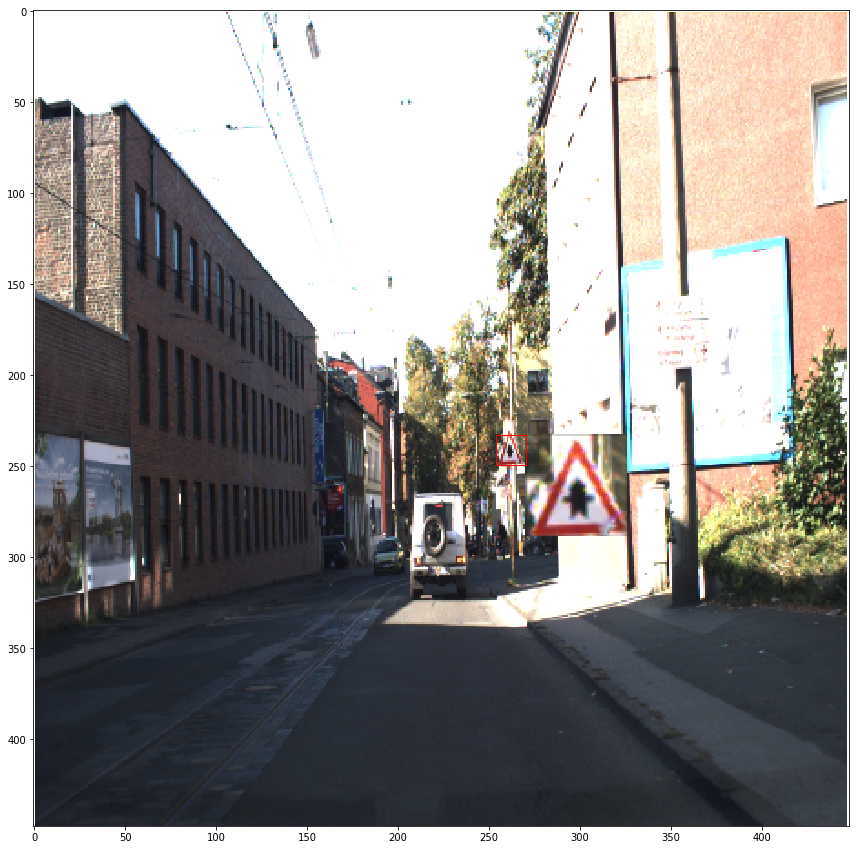

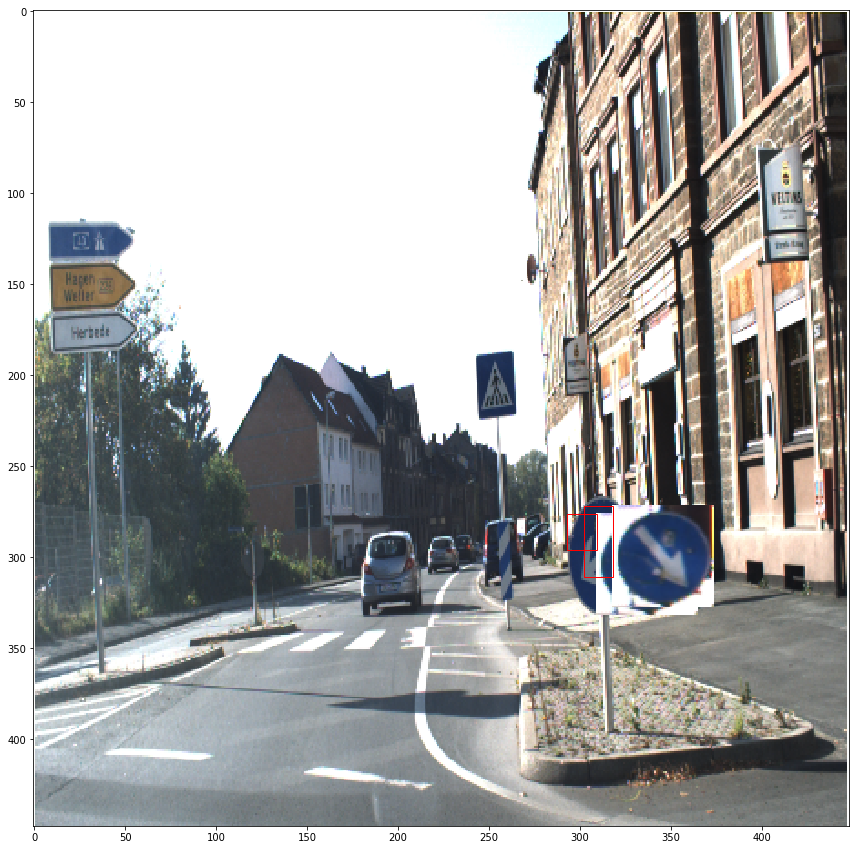

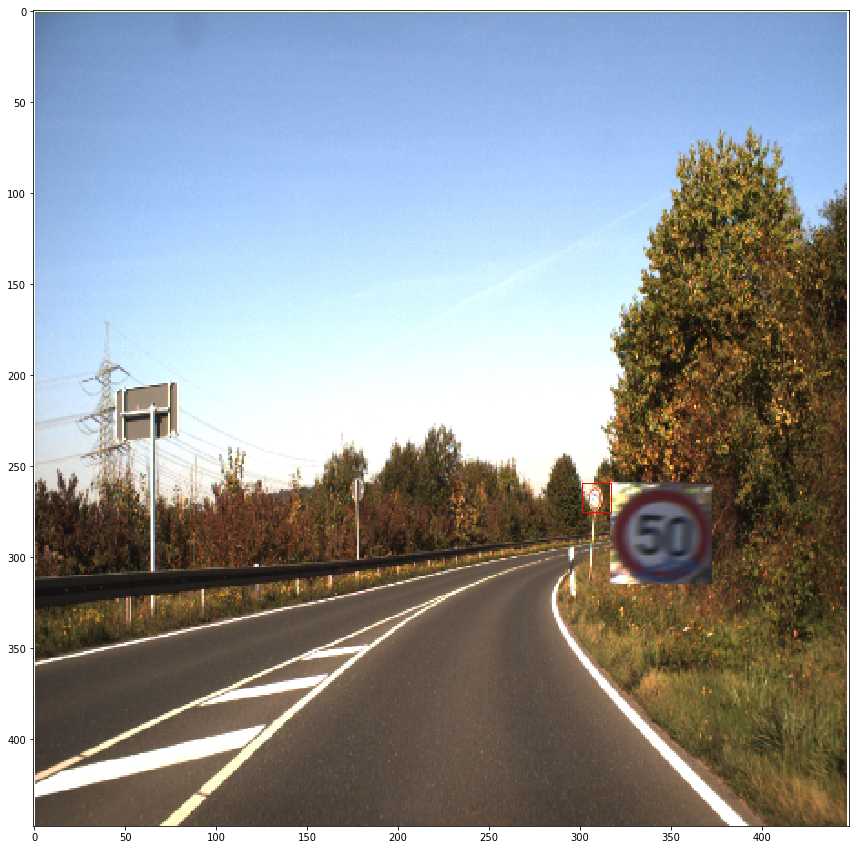

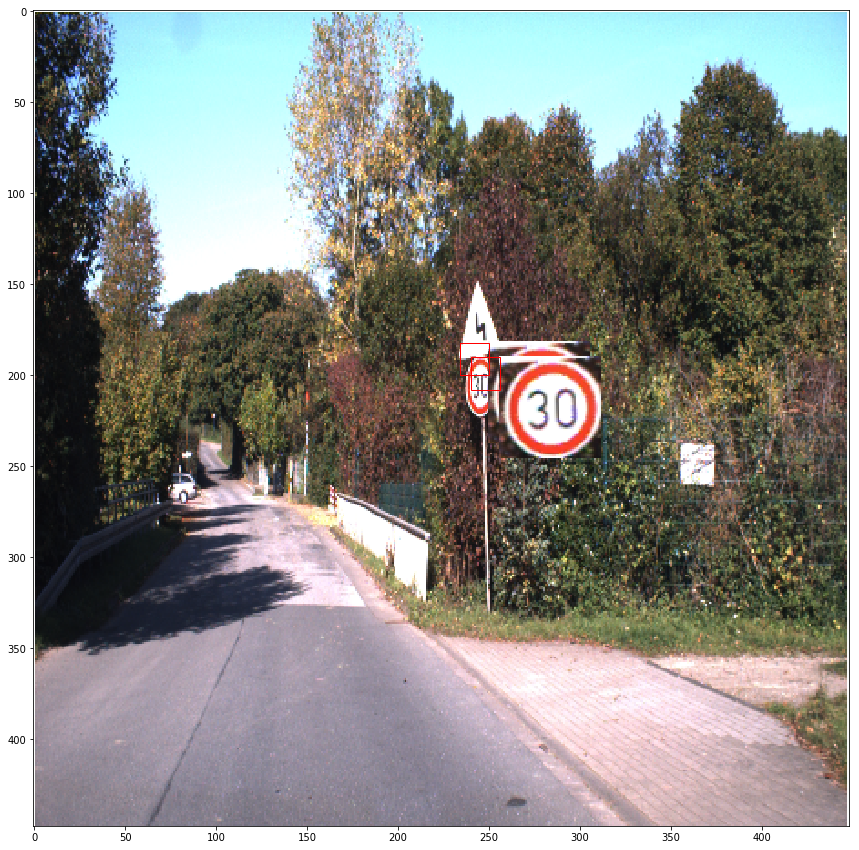

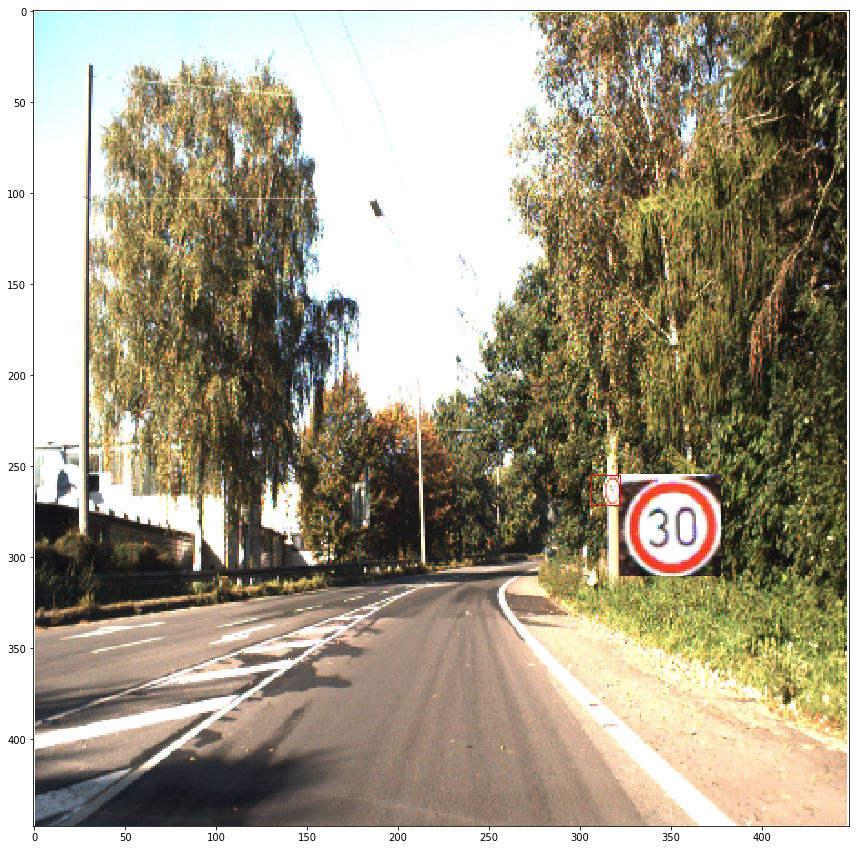

...

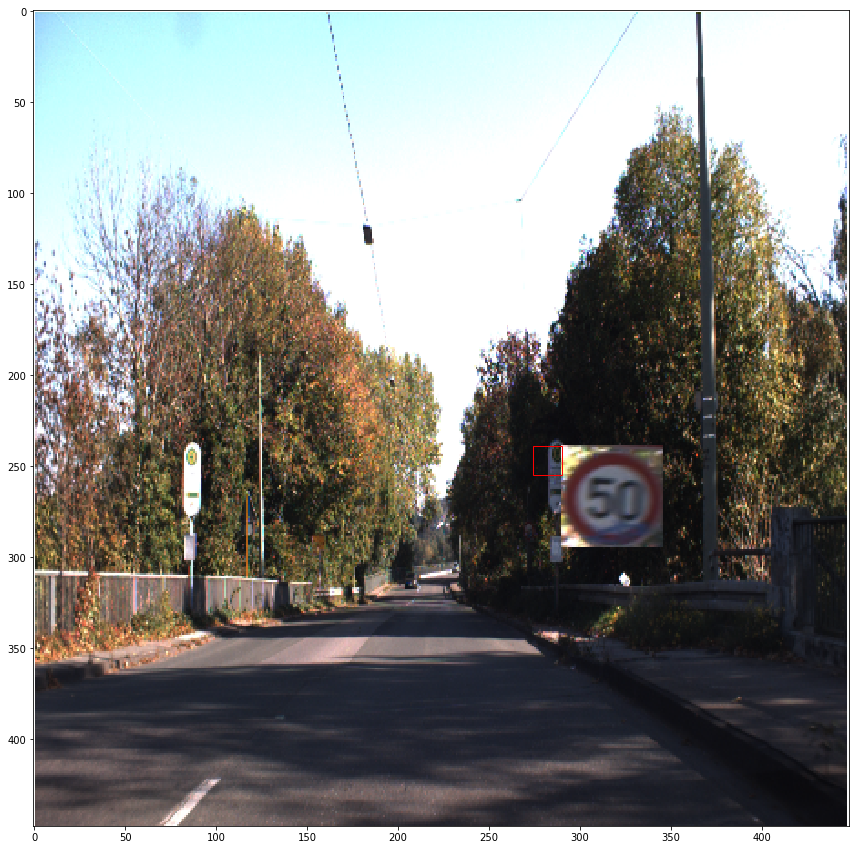

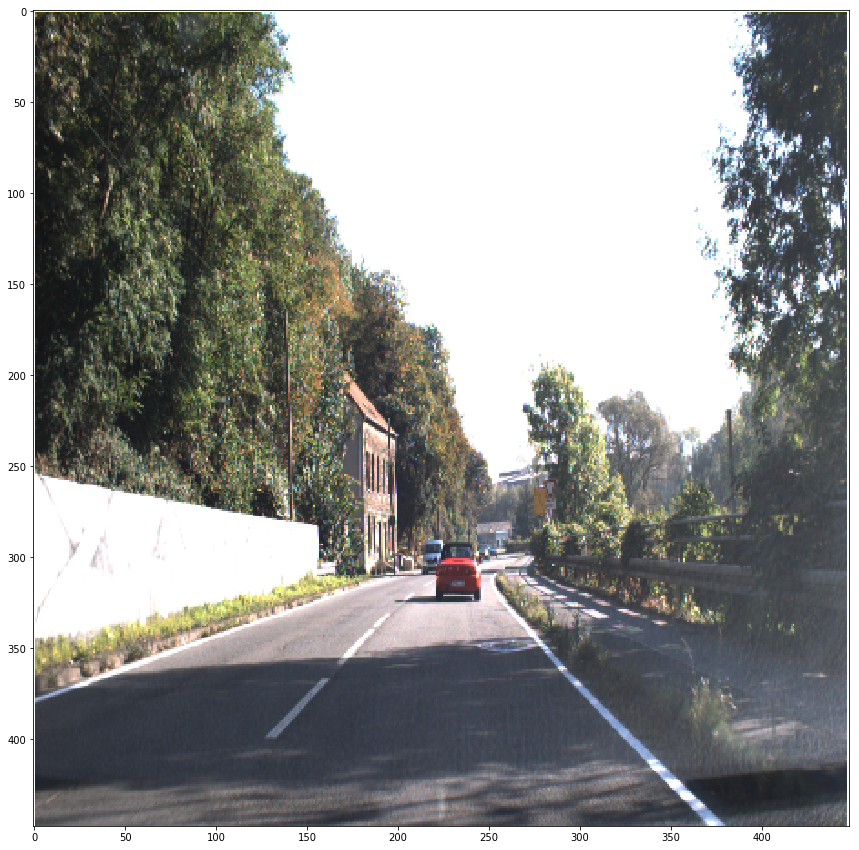

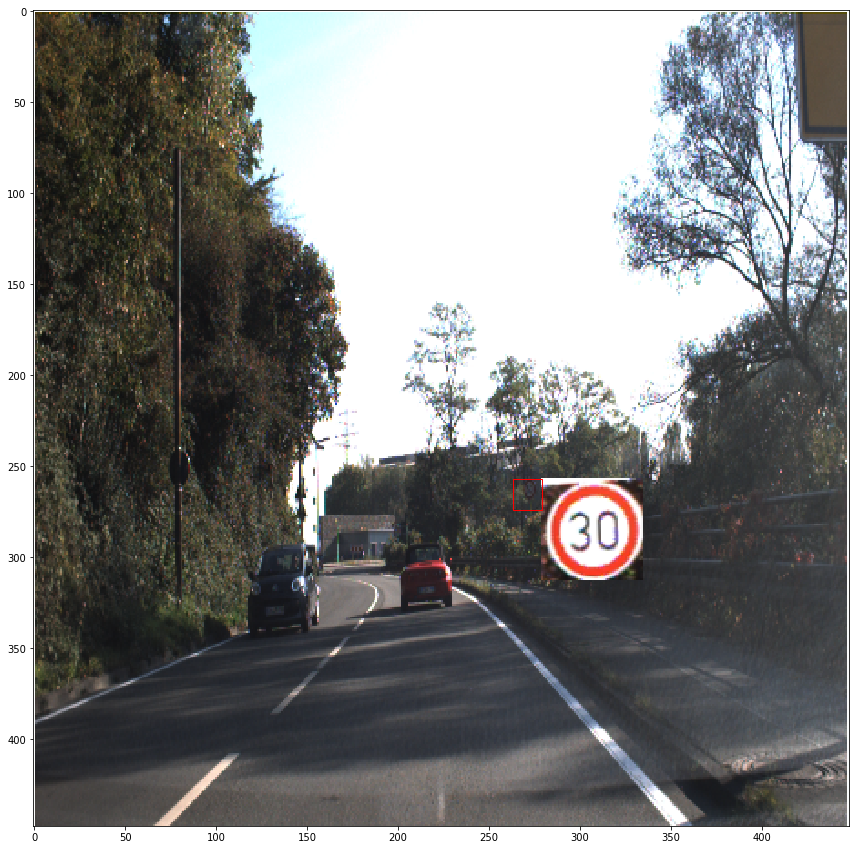

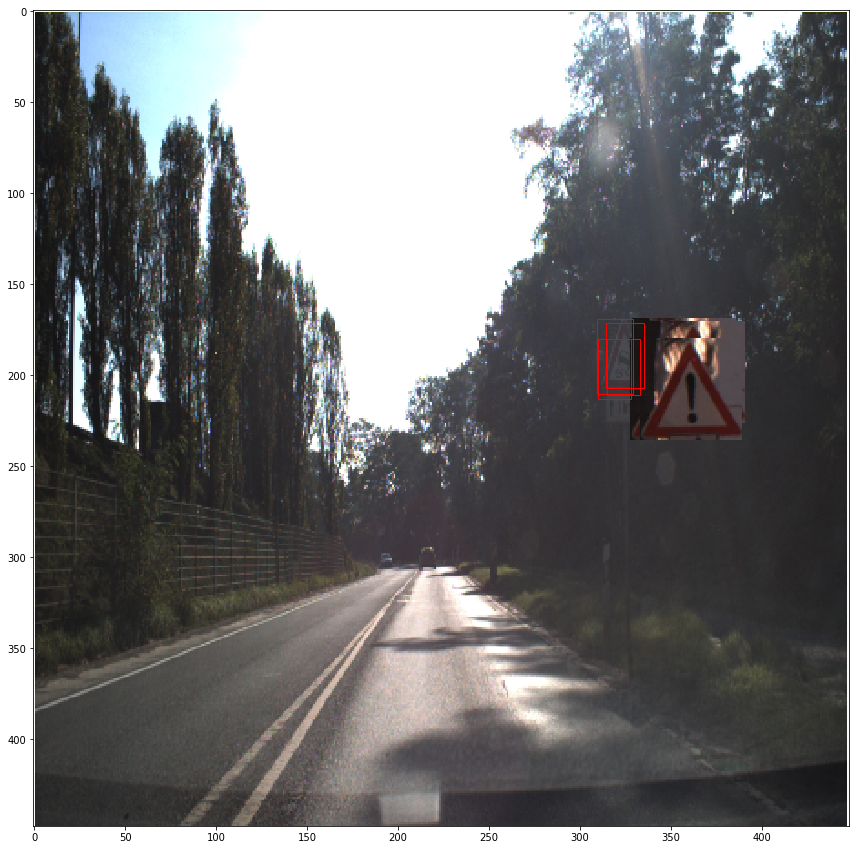

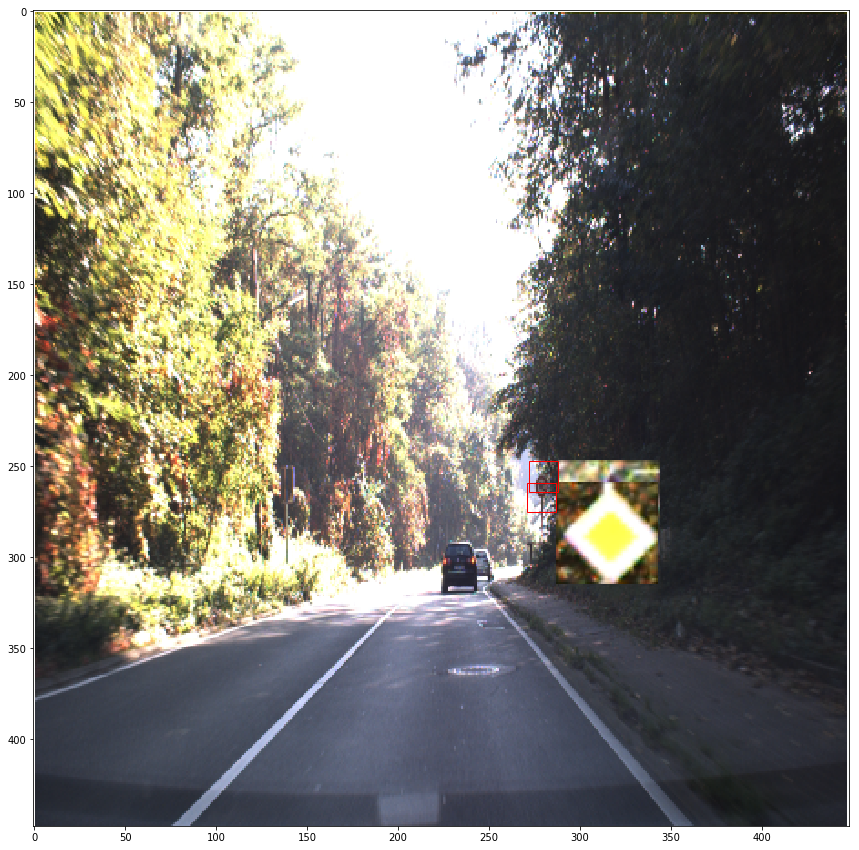

In [369]:
x,y,b_clas,b_bb=load_batch(isTrain=False)
write_results(valid_res_path)